In [ ]:
# DO NOT RUN THIS CELL IF YOU ARE EXECUTING THE NOTEBOOK LOCALLY!
# This is purely for setting up the environment on Google Colab

%%capture
!pip install mcramp
!wget https://raw.githubusercontent.com/gcassella/RAMP/notebooks/03_mesh_imaging/imaging.json
!wget https://raw.githubusercontent.com/gcassella/RAMP/notebooks/03_mesh_imaging/can.stl
!wget https://raw.githubusercontent.com/gcassella/RAMP/notebooks/03_mesh_imaging/monkey.stl

In [157]:
import mcramp as mcr
import pyopencl as cl
import numpy as np
import matplotlib.pyplot as plt

ctx = cl.create_some_context()
queue = cl.CommandQueue(ctx)

# Execute instrument with empty can

In [158]:
inst = mcr.Instrument(
    'imaging.json', 
    ctx, 
    queue, 
    Ei=5.2,
    sample_disable="'true'",
    sample_name="'monkey.stl'"
)
N = int(1e8)
inst.execute(N)
X,Y,Z_nosample,E_nosample=inst.data()['Detector']

# Execute instrument with monkey sample

In [159]:
inst = mcr.Instrument(
    'imaging.json', 
    ctx, 
    queue, 
    Ei=5.2,
    sample_disable="'false'",
    sample_name="'monkey.stl'"
)
N = int(1e8)
inst.execute(N)
X,Y,Z_sample,E_sample=inst.data()['Detector']

# Plot results

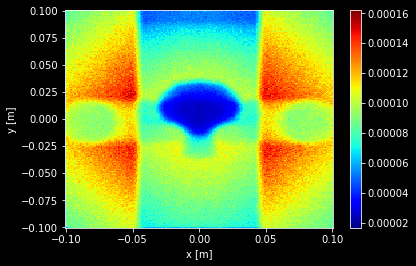

In [160]:
plt.pcolormesh(X,Y,Z_sample,shading='auto',cmap='jet')
plt.xlabel('x [m]')
plt.ylabel('y [m]')
plt.colorbar()
#plt.savefig('can_with_monkey_sample.png')

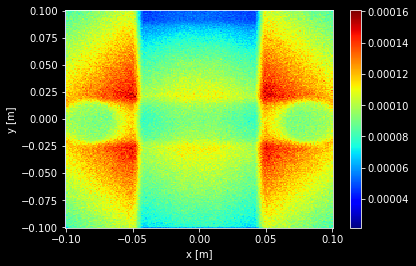

In [161]:
plt.pcolormesh(X,Y,Z_nosample,shading='auto',cmap='jet')
plt.xlabel('x [m]')
plt.ylabel('y [m]')
plt.colorbar()
#plt.savefig('can_empty.png')

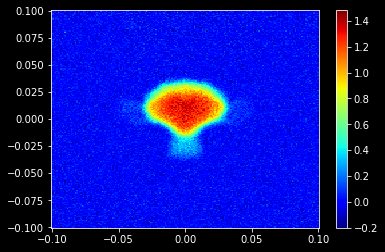

In [162]:
plt.pcolormesh(X,Y,-np.log(Z_sample/Z_nosample),shading='auto',cmap='jet', vmin=-0.2)
plt.colorbar()
#plt.savefig('ratio.png')